### Dataset1:Vincent Van Gogh

I start with a particular artist. Vincent van Gogh, one of the most representative painters of Post-Impressionism in Dutch, is the first artist I dig into.

In [9]:
#import library
import pandas as pd
import requests
import time
import matplotlib.pyplot as plt
from PIL import Image

### **Step1**

Data Aquisition: Rijksmuseum ApI

By combining the two APIs of Rijksmuseum, I set the artist's name(involvedMaker)as a variable and build a small pandas data frame and then use the unique object number of each artwork to acquire its detailed information covering the title, url_image, maker, width, height, colors, description, place of birth, date of birth, place of death, date of death, occupation, roles, nationality, production places, acquisition_method, acquisition_date, materials, icon class description, physical medium.


In [5]:
#keys and url
api_key ="XXX"
involvedMaker="Vincent+van+Gogh"
url="https://www.rijksmuseum.nl/api/nl/collection?key="+api_key+"&involvedMaker="+involvedMaker+"&chronologic&ps=100"
response = requests.get(url).json()

#data store in pandas
df_v = pd.DataFrame(columns=['objectNumber','title'])

# first search general info via key word;
for artobject in response['artObjects']:
    if artobject['principalOrFirstMaker'] == 'Vincent van Gogh':
      objectNumber = artobject['objectNumber']
      title = artobject['title']
      url_image = artobject['webImage']['url']
#then use objectNumber as the primary key to link details;
#remove T in time and turn list into str;
      url_detail = "https://www.rijksmuseum.nl/api/nl/collection/"+objectNumber+"?key="+api_key
      response_detail = requests.get(url_detail).json()
      colors = response_detail['artObject']['colors']
      description = response_detail['artObject']['description']
      presentingDate = response_detail['artObject']['dating']['presentingDate']
      productionPlaces = response_detail['artObject']['principalMakers'][0]['productionPlaces']
      productionPlaces_str = ", ".join(productionPlaces)
      acquisition_date = response_detail['artObject']['acquisition']['date']
      acquisition_date = acquisition_date.split('T')[0]
      materials = response_detail['artObject']['materials']
      materials_str = ", ".join(materials)
      iconClassDescription = response_detail['artObject']['classification']['iconClassDescription']
      iconClassDescription_str = ", ".join(iconClassDescription)
      physicalMedium = response_detail['artObject']['physicalMedium'] 
      #print(objectNumber)
 
 #append all data needed into pandas dataframe;     
      df_v=df_v.append({'objectNumber':objectNumber,
       'title':title,'url':url_image, 
        'colors':colors,'description':description,
          'productionPlaces':productionPlaces_str,
           'acquisition_date':acquisition_date,
           'materials':materials_str,'iconClassDescription':iconClassDescription_str,
           'physicalMedium':physicalMedium,'presentingDate':presentingDate}, ignore_index=True)

/var/folders/x7/2_kqx0w15sb52_lb12v8t4nm0000gn/T/ipykernel_53215/2124886942.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_v=df_v.append({'objectNumber':objectNumber,
/var/folders/x7/2_kqx0w15sb52_lb12v8t4nm0000gn/T/ipykernel_53215/2124886942.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_v=df_v.append({'objectNumber':objectNumber,
/var/folders/x7/2_kqx0w15sb52_lb12v8t4nm0000gn/T/ipykernel_53215/2124886942.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_v=df_v.append({'objectNumber':objectNumber,
/var/folders/x7/2_kqx0w15sb52_lb12v8t4nm0000gn/T/ipykernel_53215/2124886942.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.conca

In [6]:
df_v

,objectNumber,title,acquisition_date,colors,description,iconClassDescription,materials,physicalMedium,presentingDate,productionPlaces,url
0,SK-A-3262,Zelfportret,1936-06-01,"[{'percentage': 44, 'hex': '#52686D'}, {'perce...",Zelfportret van Vincent van Gogh. Borstbeeld m...,"portrait, self-portrait of painter, portrait, ...","karton, olieverf",olieverf op karton,1887,,https://lh3.googleusercontent.com/Ckjq-HkB2XhE...
1,RP-T-1962-65,Landschap bij de abdij van Montmajour te Arles,1962-01-01,[],None,"plain, abbey, monastery, convent ~ Roman Catho...","papier, krijt, inkt, potlood","potlood, rietpen en verenpen in inkt, op velij...",1888,,https://lh6.ggpht.com/d91eLpUD7w8vhaGPWNvuzmkU...
2,RP-T-1952-125,Schelpenvisser,1952-04-08,[],None,"fisherman, sports, games ~ animals","papier, potlood, krijt","potlood en zwart krijt, penseel in kleuren, op...",1863 - 1890,,https://lh4.ggpht.com/p0gQfwn5ryZ6Fazbkv9dG2MG...
3,SK-A-2226,Boerderij in de Provence,1906-04-01,"[{'percentage': 54, 'hex': '#D5C6A4'}, {'perce...",None,"folk costume, regional costume","papier, potlood",potlood en pen in bruin op papier,ca. 1888,,https://lh3.ggpht.com/3fR9EhgRFF_kz66r1WVv7Gtg...
4,SK-A-2227,"Korensnijder met hoed, van achteren gezien",1906-04-01,[],None,"reaping, picking, mowing ~ harvest, agricultur...","papier, krijt, potlood","potlood, zwart krijt en penseel in bruin",1885,,https://lh5.ggpht.com/LeONPNh8oPUpjMUWxUe3d0G_...
5,RP-P-OB-20.603,Portret van dr. Gachet,1905-01-01,"[{'percentage': 41, 'hex': '#BFB69A'}, {'perce...","Portret van dokter Paul Ferdinand Gachet, pijp...","historical persons, medicine, medical science ...",papier,ets,1890,Auvers-sur-Oise,https://lh5.ggpht.com/eiAJJM9_EByX03PBlrRBULoa...
6,RP-P-1912-609,De aardappeleters,1912-01-01,"[{'percentage': 26, 'hex': '#59544D'}, {'perce...",Lithografische versie van Van Goghs 'Aardappel...,"(family) meal, farmers",papier,lithografie in zwart,1885,Nuenen,https://lh6.ggpht.com/GlyQgIZEno8P_XhZK1yTsMk9...
7,SK-A-2225,Weg achter de pastorietuin te Nuenen,1906-04-01,"[{'percentage': 29, 'hex': '#C4B291'}, {'perce...",Weg met knotwilgen en een man met een kruiwagen.,"trees: pollard willow, male sex; man, carrying...","papier, potlood","potlood, pen en penseel in bruin",1884,,https://lh5.ggpht.com/QjSoKZOeS1lkYXUgPHgy9W3Z...
8,SK-A-3662,Bloemkwekerij van Pierre van de Putte aan de S...,1944-01-01,"[{'percentage': 1, 'hex': '#383C37'}, {'percen...",None,"garden, horticulture, vegetable culture, marke...","papier, dekverf, potlood","potlood, pen en penseel in inkt, gewassen, geh...",1882,Den Haag,https://lh6.ggpht.com/RvKoP3sO4nXgRlIvSGLDcezV...
9,SK-A-3307,Boerendorp in de avond,1940-03-01,"[{'percentage': 20, 'hex': '#8E8459'}, {'perce...",Gezicht op een dorp in de avond. Aan de rand v...,"village, evening","doek, olieverf",olieverf op doek,1884,,https://lh3.googleusercontent.com/rN30IB00bIGE...


In [7]:
#save to csv;
df_v.to_csv("VanGogh_Rijks.csv")

After forming the database, I first select one particular artwork---the Self Portrait of Vincent van Gogh and visualize the color composition via a bar chart and the painting image is attached for comparison.

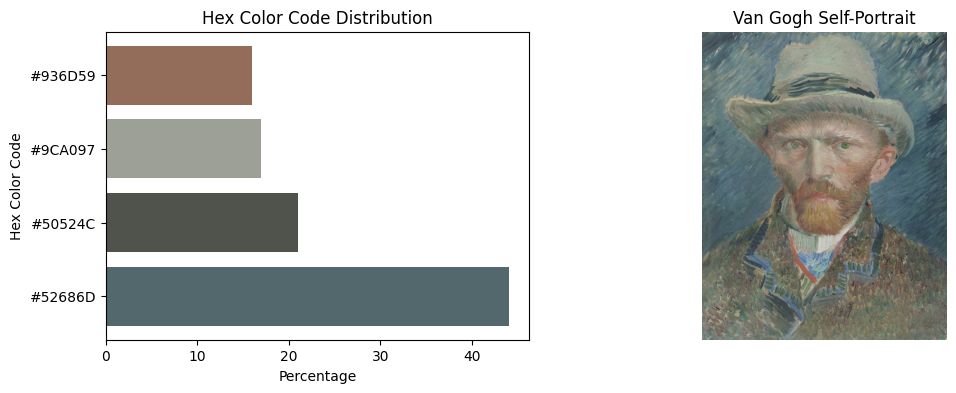

In [118]:
#visulize hex code for Zelfportret;
colors_Zelfportret = df_v.iloc[0,3]
img = Image.open('selfportrait.jpeg')

# Extract the color codes and percentages from the metadata
color_codes = [color['hex'].strip() for color in colors_Zelfportret if color['percentage'] != 0]
percentages = [color['percentage'] for color in colors_Zelfportret if color['percentage'] != 0]

# Create a horizontal bar chart
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 4))

# Plot the hex color distribution in the left subplot
ax1.barh(color_codes, percentages, color=color_codes)
ax1.set_xlabel('Percentage')
ax1.set_ylabel('Hex Color Code')
ax1.set_title('Hex Color Code Distribution')

# Plot the self-portrait image in the right subplot
ax2.imshow(img)
ax2.axis('off')
ax2.set_title('Van Gogh Self-Portrait')

# Show the plot
plt.show()

Among the ten paintings in our small van Gogh dataset, seven of them contains hex color code. Thus, we are able to see color pie chart from seven paintings. It's clear to see the color choice is somber ang gloomy.

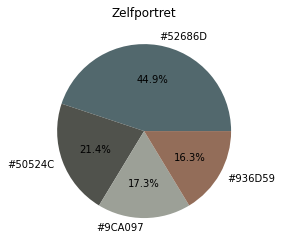

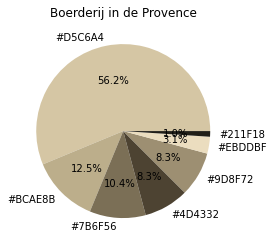

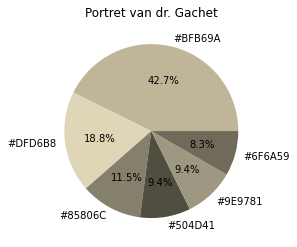

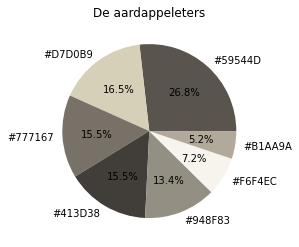

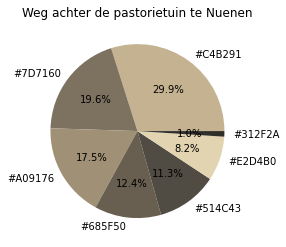

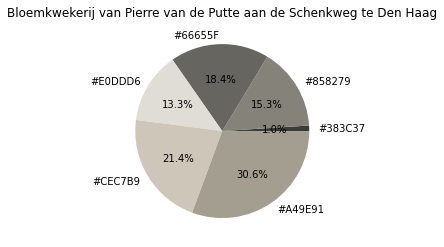

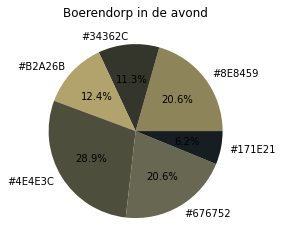

In [15]:
paintings_vangogh = df_v.iloc[:,[1,3]]

# Loop over each painting and create a pie chart
for i in range(len(paintings_vangogh)):
    # Get the color data for the painting
    colors = paintings_vangogh.iloc[i]['colors']

    color_codes = []
    percentages = []
    for color in colors:
        if color['percentage'] != 0:
            color_codes.append(color['hex'].strip())
            percentages.append(color['percentage'])
    
    # Create the pie chart
    if color_codes and percentages:
        fig, ax = plt.subplots(figsize=(4, 4))
        ax.pie(percentages, labels=color_codes, colors=color_codes, autopct='%1.1f%%')
        ax.set_title(paintings_vangogh.iloc[i]['title'])
    
    # Show the plot
    plt.show()


The Vincent van Gogh data extracted from Rijksmuseum is quite small so I want to get more artworks from other sources. Wikipedia has a more complete dataset of Vincent van Gogh with key parameters including image, date, and location. The only issue of it is the lack of hex color code. Then, I find out the method of extracting hex code from the image in Python which will help to fulfill my dataset.

### **Step2:**

Data Aquisition: Wikipedia API + Image hex code extraction

In [16]:
#import libraries
import pandas as pd 
import requests 
from bs4 import BeautifulSoup # parse HTML documents
import matplotlib.pyplot as plt
import re
import folium # map
from folium.plugins import HeatMap

In [17]:
# get the response in the form of html
wikiurl="https://en.wikipedia.org/wiki/List_of_works_by_Vincent_van_Gogh"
table_class="wikitable sortable jquery-tablesorter"
response=requests.get(wikiurl)
print(response.status_code)

200


In [ ]:
#display max columns
pd.set_option('display.max_rows',None)

In [18]:
# For all paintings, there are 6 tables with different created locations. Get all tables and append them together;
# The tables are: Paintings (Nuenen-Antwerp),Paintings (Paris),Paintings (Arles),Paintings (Saint-Rémy),Paintings (Auvers-sur-Oise);
# parse data from the html into a beautifulsoup object
soup = BeautifulSoup(response.text, 'html.parser')
tables = soup.find_all('table', {'class':"wikitable"})
tables_paintings = []
for i in range(1, 7):
    table = pd.read_html(str(tables))[i]
    tables_paintings.append(table)

# concatenate the tables together
df_VVG = pd.concat(tables_paintings)

# reset the index
df_VVG.reset_index(inplace=True, drop=True)

# print the first few rows of the concatenated dataframe
df_VVG

,ImageTitle,Date,Current location,Created in,"Medium,Dimensions",.mw-parser-output .tooltip-dotted{border-bottom:1px dotted;cursor:help}No.,No.,Catalogue No.
0,Still Life with Cabbage and Clogs,November-December 1881,"Van Gogh Museum, Amsterdam",The Hague,Oil on paper on panel34 x 55 cm,F 1JH 81,NaN,NaN
1,Beach at Scheveningen in Calm Weather,August 1882,"Minnesota Marine Art Museum, Winona",The Hague,35.5 x 49.5 cm,F 2JH 173,NaN,NaN
2,Dunes,August 1882,Private collection,The Hague,Oil on panel36 x 58.5 cm,F 2aJH 176,NaN,NaN
3,Women Mending Nets in the Dunes,August 1882,Private collection,The Hague,Oil on paper on panel42 x 62.5 cm,F 7JH 178,NaN,NaN
4,"A Girl in the Street, Two Coaches in the Backg...",August 1882,"Villa Flora, Winterthur",The Hague,Oil on canvas on panel42 x 53 cm,F 13JH 179,NaN,NaN
...,...,...,...,...,...,...,...,...
863,The Fields,July 1890,Private collection,Auvers-sur-Oise,50 x 65cm,NaN,NaN,F 761JH 2120
864,Haystacks under a Rainy Sky,July 1890,"Kröller-Müller Museum, Otterlo",Auvers-sur-Oise,64 x 52.5cm,NaN,NaN,F 563JH 2121
865,View of Auvers with Church (van Gogh),July 1890,"Rhode Island School of Design Museum, Providence",Auvers-sur-Oise,34 x 42cm,NaN,NaN,F 800JH 2122
866,Wheat Fields with Auvers in the Background,July 1890,Private collection,Auvers-sur-Oise,43 x 50cm,NaN,NaN,F 801JH 2123


Vincent van Gogh produced more than 2,000 artworks, consisting of around 900 paintings and 1,100 drawings and sketches. Here, we gathered 868 oil paintings of him.(Exclude his water color, drawings and sketches)

In [20]:
#Clean the dataframe VVG(Vincent van Gogh), drp unwanted colums,rename column names;
data_VVG = df_VVG.drop(['.mw-parser-output .tooltip-dotted{border-bottom:1px dotted;cursor:help}No.','No.','Catalogue No.','Medium,Dimensions'],axis=1)
data_VVG = data_VVG.rename(columns = {'Image Title':'Title','Created in':'Place Created','Current location':'Place Stored'})
data_VVG

,ImageTitle,Date,Place Stored,Place Created
0,Still Life with Cabbage and Clogs,November-December 1881,"Van Gogh Museum, Amsterdam",The Hague
1,Beach at Scheveningen in Calm Weather,August 1882,"Minnesota Marine Art Museum, Winona",The Hague
2,Dunes,August 1882,Private collection,The Hague
3,Women Mending Nets in the Dunes,August 1882,Private collection,The Hague
4,"A Girl in the Street, Two Coaches in the Backg...",August 1882,"Villa Flora, Winterthur",The Hague
...,...,...,...,...
863,The Fields,July 1890,Private collection,Auvers-sur-Oise
864,Haystacks under a Rainy Sky,July 1890,"Kröller-Müller Museum, Otterlo",Auvers-sur-Oise
865,View of Auvers with Church (van Gogh),July 1890,"Rhode Island School of Design Museum, Providence",Auvers-sur-Oise
866,Wheat Fields with Auvers in the Background,July 1890,Private collection,Auvers-sur-Oise


In [21]:
#check NA values;
data_VVG.isna().sum()

ImageTitle       0
Date             0
Place Stored     0
Place Created    0
dtype: int64

In [ ]:
#check duplicates;
#data_VVG.drop_duplicates(inplace = True)
#data_VVG

In [22]:
#check data types;
data_VVG.dtypes

ImageTitle       object
Date             object
Place Stored     object
Place Created    object
dtype: object

In [23]:
#check wrong value;
data_VVG['Place Created'].value_counts()
#Two wrong value

Paris              226
Nuenen             192
Arles              186
Saint-Rémy         143
Auvers-sur-Oise     77
The Hague           27
Antwerp              7
Nieuw-Amsterdam      3
Drenthe              3
Scheveningen         1
38.8 x 31.3 cm       1
43.2 x 34.2 cm       1
Amsterdam            1
Name: Place Created, dtype: int64

In [208]:
#locate wrong values, 137/143
data_VVG.loc[(data_VVG['Place Created'] == '38.8 x 31.3 cm')]
#data_VVG.loc[(data_VVG['Place Created'] == '43.2 x 34.2 cm')]

,Title,Date,Place Stored,Place Created
137,Head of a Woman,"Van Gogh Museum, Amsterdam",Nuenen,38.8 x 31.3 cm


In [24]:
#replace wrong values;
data_VVG.loc[137,['Date','Place Stored','Place Created']] = ['1885','Van Gogh Museum, Amsterdam','Nuenen']
data_VVG.loc[143,['Date','Place Stored','Place Created']] = ['April 1885','Van Gogh Museum, Amsterdam','Nuenen']

In [25]:
data_VVG['Date'].value_counts()

1887                      130
1886                       94
June 1890                  38
September 1889             24
July 1890                  24
                         ... 
March-April 1888            1
April-May 1888              1
4 July 1888                 1
Autumn 1888                 1
November-December 1881      1
Name: Date, Length: 88, dtype: int64

In [26]:
#replace period to a particular year;
replace = {'1884-85': '1885', '1885-86': '1886'}
data_VVG['Date'] = data_VVG['Date'].replace(replace, regex=True)

#use re to extract 4digit from the date;
def get_year(date):
   year = re.findall(r'\d{4}', date)
   if year:
       return int(year[0])
   else:
       return None

data_VVG['Date'] = data_VVG['Date'].apply(get_year)
data_VVG['Date']

0      1881
1      1882
2      1882
3      1882
4      1882
       ... 
863    1890
864    1890
865    1890
866    1890
867    1890
Name: Date, Length: 868, dtype: int64

In [29]:
#Groupby date and place, count the number of works as a new column
summary_df = data_VVG.groupby(['Date', 'Place Created'])['ImageTitle'].agg('count').reset_index()
summary_df.rename(columns={'ImageTitle':'Count'},inplace=True)
summary_df

,Date,Place Created,Count
0,1881,The Hague,1
1,1882,Scheveningen,1
2,1882,The Hague,13
3,1883,Drenthe,3
4,1883,Nieuw-Amsterdam,3
5,1883,The Hague,13
6,1884,Nuenen,53
7,1885,Amsterdam,1
8,1885,Antwerp,6
9,1885,Nuenen,141


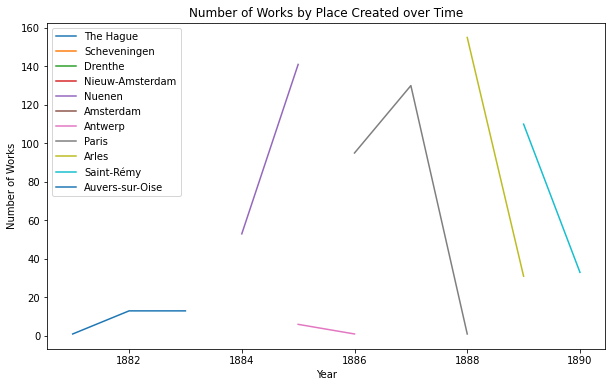

In [30]:
# create a figure and axis object
fig, ax = plt.subplots(figsize=(10,6))

# group the dataframe by place and get the count for each year
grouped = summary_df.groupby(['Place Created','Date']).sum()

# iterate through each place and plot a line for its count over time
for place in summary_df['Place Created'].unique():
    data = grouped.loc[place]
    ax.plot(data.index, data['Count'], label=place)

# set the title and axis labels
ax.set_title('Number of Works by Place Created over Time')
ax.set_xlabel('Year')
ax.set_ylabel('Number of Works')

# add a legend
ax.legend()

# show the plot
plt.show()

Hex code and Percentage Extraction:

I extract the color from my local file path, and assemble the cities files together.

In [33]:
!pip install --upgrade extcolors

In [35]:
# libraries for color extraction
import os
from PIL import Image
from PIL import ImageFile
import extcolors
# ignore truncated images; 
ImageFile.LOAD_TRUNCATED_IMAGES = True

In [38]:
# function to convert RGB to HEX code
def rgb2hex(r, g, b):
    return '#{:02x}{:02x}{:02x}'.format(r, g, b)

# function to extract color data and convert to dataframe
def color_to_df(input):
    colors_pre_list = str(input).replace('([(','').split(', (')[0:-1]
    df_rgb = [i.split('), ')[0] + ')' for i in colors_pre_list]
    df_percent = [i.split('), ')[1].replace(')','') for i in colors_pre_list]
    
    # convert RGB to HEX code
    df_color_up = [rgb2hex(int(i.split(", ")[0].replace("(","")),
                          int(i.split(", ")[1]),
                          int(i.split(", ")[2].replace(")",""))) for i in df_rgb]
    
    df = pd.DataFrame(zip(df_color_up, df_percent), columns = ['c_code','occurence'])
    return df

# specify directory containing images
dir_path = '/images/Vincent van Gogh/Amesterdam'

# create an empty list to store color dataframes
df_list = []

# loop through each file in directory
for filename in os.listdir(dir_path):
    # check if file is an image
    if filename.endswith('.jpg') or filename.endswith('.jpeg') or filename.endswith('.png'):
        # open image
        img_path = os.path.join(dir_path, filename)
        img = Image.open(img_path)
        # resize image
        output_width = 900 
        wpercent = (output_width/float(img.size[0]))
        hsize = int((float(img.size[1])*float(wpercent)))
        img = img.resize((output_width,hsize), Image.ANTIALIAS)
        # extract color data
        colors_x = extcolors.extract_from_path(img_path, tolerance=12, limit=12)
        df_color = color_to_df(colors_x)
        df_color['percentage'] = (df_color['occurence'].astype('float')*100/df_color['occurence'].astype('float').sum()).round(2)
        df_color['filename'] = filename
        # add color dataframe to list
        df_list.append(df_color)

# concatenate all color dataframes into one
df_Amesterdam = pd.concat(df_list, ignore_index=True)

# print dataframe
print(df_Amesterdam)

     c_code occurence  percentage  \
0   #726c54  17924912       45.39   
1   #594f34   7307313       18.50   
2   #948b6a   6140671       15.55   
3   #1d200f   3984457       10.09   
4   #101211   2216658        5.61   
5   #3b3418   1441478        3.65   
6   #b3ab87    210581        0.53   
7   #3a4213    102581        0.26   
8   #7f7246     80226        0.20   
9   #34352d     61160        0.15   
10  #582a09     22645        0.06   

                                             filename  
0   De_Ruijterkade_te_Amsterdam_-_s0085V1962_-_Van...  
1   De_Ruijterkade_te_Amsterdam_-_s0085V1962_-_Van...  
2   De_Ruijterkade_te_Amsterdam_-_s0085V1962_-_Van...  
3   De_Ruijterkade_te_Amsterdam_-_s0085V1962_-_Van...  
4   De_Ruijterkade_te_Amsterdam_-_s0085V1962_-_Van...  
5   De_Ruijterkade_te_Amsterdam_-_s0085V1962_-_Van...  
6   De_Ruijterkade_te_Amsterdam_-_s0085V1962_-_Van...  
7   De_Ruijterkade_te_Amsterdam_-_s0085V1962_-_Van...  
8   De_Ruijterkade_te_Amsterdam_-_s0085V1962_-_Van.

In [ ]:
df_Amesterdam.to_csv('Amesterdam.csv')

In [46]:
# hexcode and location 
data_hexloc = pd.read_csv('/region/Hex_Location.csv')
data_hexloc

,Unnamed: 0,c_code,occurence,percentage,filename,place
0,0,#192929,93150,35.07,Cluster_of_Old_Houses_with_the_New_Church_in_T...,Hague
1,1,#aeab98,92682,34.89,Cluster_of_Old_Houses_with_the_New_Church_in_T...,Hague
2,2,#3f2629,26244,9.88,Cluster_of_Old_Houses_with_the_New_Church_in_T...,Hague
3,3,#565a49,16123,6.07,Cluster_of_Old_Houses_with_the_New_Church_in_T...,Hague
4,4,#37433f,13078,4.92,Cluster_of_Old_Houses_with_the_New_Church_in_T...,Hague
...,...,...,...,...,...,...
9484,9484,#e0dbbe,216958,7.69,Van_Gogh_-_Weg_in_Saint-Rémy_mit_weiblicher_Fi...,Saint Rémy
9485,9485,#aba78e,195641,6.94,Van_Gogh_-_Weg_in_Saint-Rémy_mit_weiblicher_Fi...,Saint Rémy
9486,9486,#e4e3df,174324,6.18,Van_Gogh_-_Weg_in_Saint-Rémy_mit_weiblicher_Fi...,Saint Rémy
9487,9487,#948b50,160755,5.70,Van_Gogh_-_Weg_in_Saint-Rémy_mit_weiblicher_Fi...,Saint Rémy


### Step3：
Data Exploration and Analysis


#### Parameter1: Color

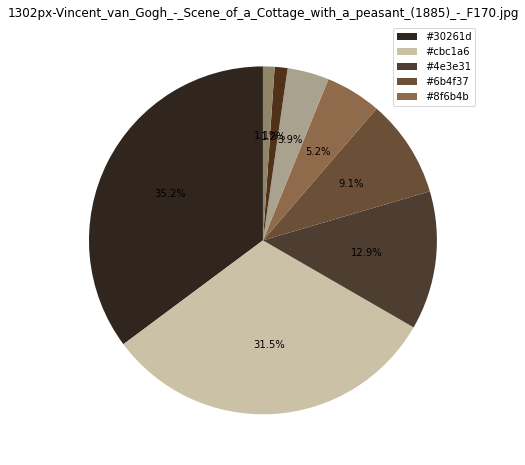

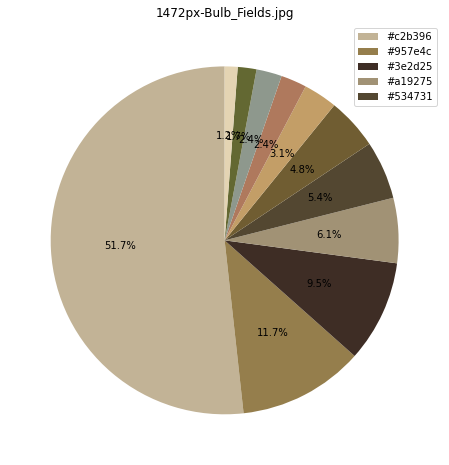

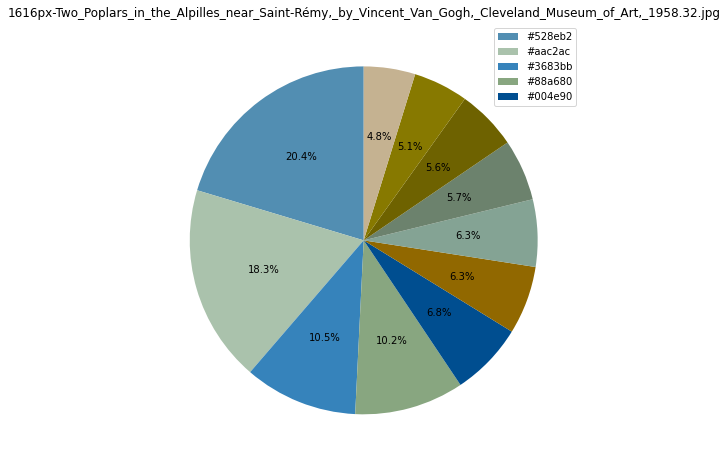

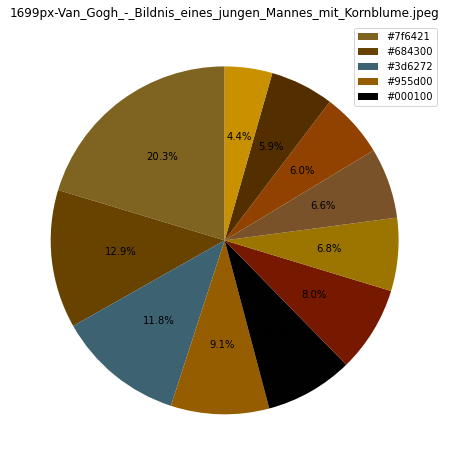

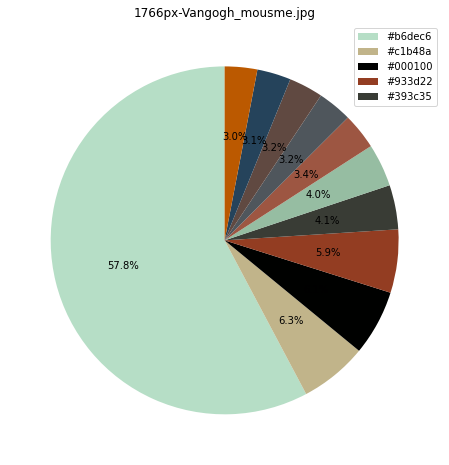

...

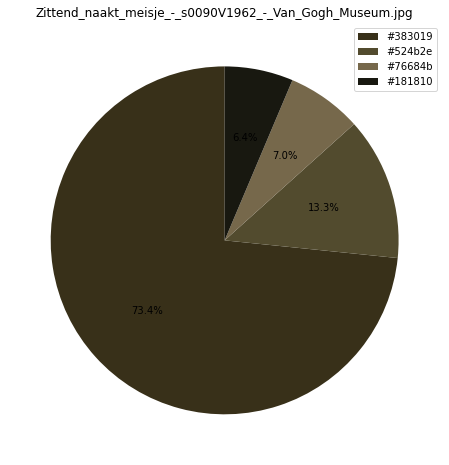

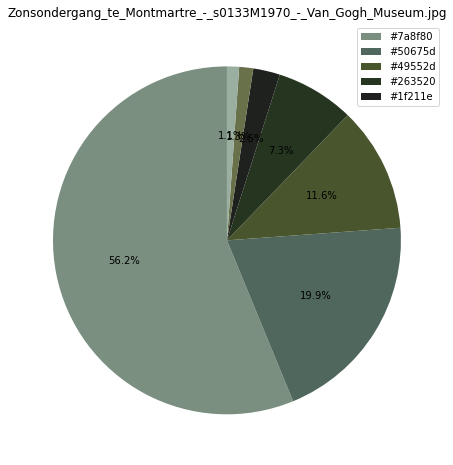

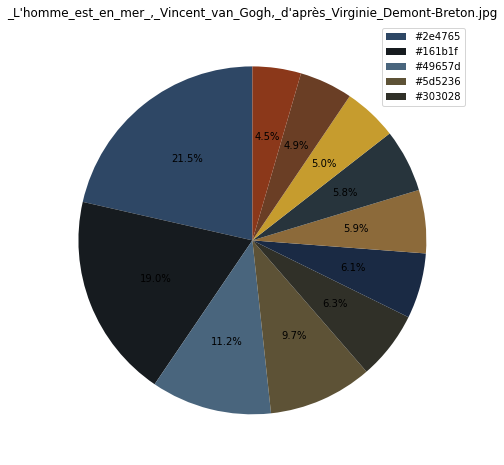

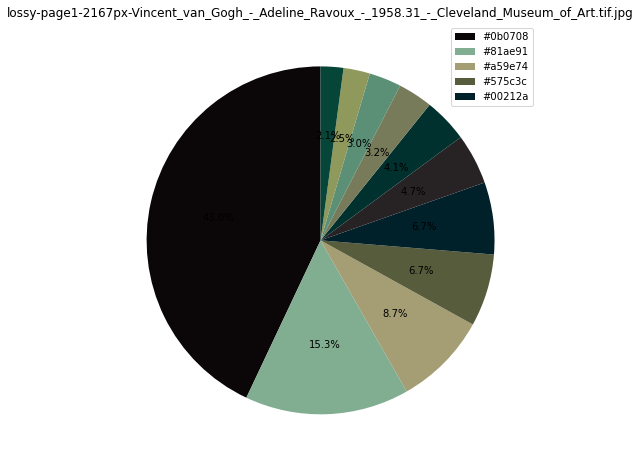

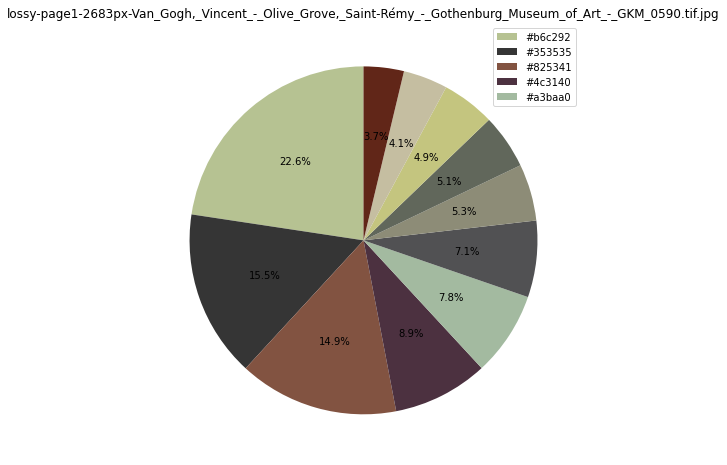

In [47]:
# Color composition of Van Gogh's paintings
# Group the data by filename and calculate the total percentage for each painting
grouped_data = data_hexloc.groupby("filename").sum()

# Function to create a pie chart given the color and percentage data
def create_pie_chart(colors, title):
    color_values = colors[colors["percentage"] >= 1]["c_code"]
    percentages = colors[colors["percentage"] >= 1]["percentage"]

    plt.figure(figsize=(8, 8))
    plt.pie(percentages, colors=color_values, autopct='%1.1f%%', startangle=90)
    plt.title(title)
    plt.legend(color_values[:5], loc='upper right')
    plt.show()

# Iterate through each unique painting and create a pie chart
for index, row in grouped_data.iterrows():
    title = index
    colors = data_hexloc[data_hexloc["filename"] == title]
    create_pie_chart(colors, title)

#### Parameter2: Place

In [31]:
#Which city van Gogh created most of his works
data_VVG['Place Created'].value_counts()

Paris              226
Nuenen             194
Arles              186
Saint-Rémy         143
Auvers-sur-Oise     77
The Hague           27
Antwerp              7
Nieuw-Amsterdam      3
Drenthe              3
Scheveningen         1
Amsterdam            1
Name: Place Created, dtype: int64

<AxesSubplot:>

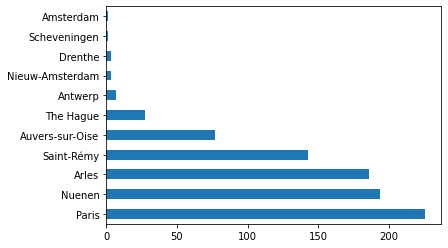

In [32]:
data_VVG['Place Created'].value_counts().plot.barh()

In [61]:
# Define the center of the map and the initial zoom level
center = [50.5, 4.0]
zoom = 8

# Create a map object and set the location and zoom level
m = folium.Map(location=center, zoom_start=zoom)

# Geometry information of our cities
data = [
    [51.4793455, 5.5426001, 194],
    [43.6766476, 4.6277763, 186],
    [43.7884802, 4.8318786, 143],
    [49.0711875, 2.1700326, 77],
    [51.2211097, 4.3997081, 7],
    [52.7092188, 6.8659616, 3],
    [52.8573817, 6.8066461, 3],
    [52.1033162, 4.3033528, 1],
    [48.85809, 2.35299, 226],
    [52.3519145, 4.9146943, 1],
    [52.0800368, 4.2699613, 27]
]

# Normalize the values
max_val = max([point[2] for point in data])
normalized_values = [point[2] / max_val for point in data]

# Create the HeatMap with the custom color range
HeatMap(data, gradient={0.0: '#4682B4', 1.0: '#008080'}, min_opacity=0.2, max_val=1.0).add_to(m)

m.save('map_VVG.html')

m

/var/folders/x7/2_kqx0w15sb52_lb12v8t4nm0000gn/T/ipykernel_53215/1909582731.py:28: UserWarning: The `max_val` parameter is no longer necessary. The largest intensity is calculated automatically.
  HeatMap(data, gradient={0.0: '#4682B4', 1.0: '#008080'}, min_opacity=0.2, max_val=1.0).add_to(m)


In [59]:
# Define the center of the map and the initial zoom level
center = [50.5, 4.0]
zoom = 8

# Create a map object and set the location and zoom level
m = folium.Map(location=center, zoom_start=zoom)

# Geolocation information of our cities
locations = [
    [51.4793455, 5.5426001],
    [43.6766476, 4.6277763],
    [43.7884802, 4.8318786],
    [49.0711875, 2.1700326],
    [51.2211097, 4.3997081],
    [52.7092188, 6.8659616],
    [52.8573817, 6.8066461],
    [52.1033162, 4.3033528],
    [48.85809, 2.35299],
    [52.3519145, 4.9146943],
    [52.0800368, 4.2699613]
]

# Image paths
image_paths = [
    'https://upload.wikimedia.org/wikipedia/commons/1/12/Vincent_van_Gogh_-_The_potato_eaters_-_Google_Art_Project.jpg',
    'https://upload.wikimedia.org/wikipedia/commons/9/94/Starry_Night_Over_the_Rhone.jpg',
    'https://upload.wikimedia.org/wikipedia/commons/0/0b/Vincent_van_Gogh_-_The_Bedroom_-_Google_Art_Project.jpg',
    'https://upload.wikimedia.org/wikipedia/commons/f/f3/Vincent_van_Gogh_-_Poppy_field_-_Google_Art_Project.jpg',
    'https://upload.wikimedia.org/wikipedia/commons/2/28/Kop_van_een_skelet_met_brandende_sigaret_-_s0083V1962_-_Van_Gogh_Museum.jpg',
    'https://upload.wikimedia.org/wikipedia/commons/7/7e/Twee_vrouwen_in_het_veen_-_s0129V1962_-_Van_Gogh_Museum.jpg',
    'https://upload.wikimedia.org/wikipedia/commons/0/00/Van_Gogh_-_Bauer%2C_Unkraut_verbrennend.jpeg',
    'https://upload.wikimedia.org/wikipedia/commons/0/0e/Zeegezicht_bij_Scheveningen_-_s0416M1990_-_Van_Gogh_Museum.jpg',
    'https://upload.wikimedia.org/wikipedia/commons/f/f6/Zelfportret_Rijksmuseum_SK-A-3262.jpeg',
    'https://upload.wikimedia.org/wikipedia/commons/0/06/De_Ruijterkade_te_Amsterdam_-_s0085V1962_-_Van_Gogh_Museum.jpg',
    'https://upload.wikimedia.org/wikipedia/commons/7/78/Bulb_Fields.jpg'
]
# Popup text
popup_texts = [
    'Nuenen: The Potato Eaters(1885)',
    'Arles: Starry Night Over the Rhone(1888)',
    'Saint-Rémy: The Bedroom(1889)',
    'Auvers-sur-Oise: Poppy Field(1890)',
    'Antwerp: Skull with a Burning Cigarette(1885-86)',
    'Nieuw-Amsterdam: Two Women in the Veen(1883)',
    'Drenthe: Bauer, Burning Weeds(1883)',
    'Scheveningen: Seascape at Scheveningen(1882)',
    'Paris: Self-Portrait(1887)',
    'Amsterdam: De Ruijterkade, Amsterdam(1885)',
    'The Hague: Bulb Fields(1883)'
]

# Create the markers with popups
for location, image_path, text in zip(locations, image_paths, popup_texts):
    popup_content = f'<h4>{text}</h4><img src="{image_path}" width="200px">'
    folium.CircleMarker(
        location=location,
        radius=15,
        color='#325C74',
        fill=True,
        fill_color='#4A777A',
        fill_opacity=0.8,
        popup=folium.Popup(popup_content, max_width=250),
    ).add_to(m)

m.save('map_popup.html')

m